In [95]:
%pylab inline
%config InlineBackend.figure_format = 'retina'

Populating the interactive namespace from numpy and matplotlib


/home/camille/miniconda/envs/boink/lib/python3.6/site-packages/IPython/core/magics/pylab.py:160: UserWarning:

pylab import has clobbered these variables: ['colors', 'display', 'slopes', '__version__', 'title']
`%matplotlib` prevents importing * from pylab and numpy



In [97]:
import matplotlib as mpl
dpi = 300
mpl.rcParams['figure.dpi']= dpi
mpl.rc("savefig", dpi=dpi)

In [2]:
import pandas as pd
import seaborn as sns
from ficus import FigureManager
from IPython.display import FileLink
import glob
import os
from collections import OrderedDict
import matplotlib.pyplot as plt
from scipy.io.wavfile import write as write_wav
from pydub import AudioSegment
import tempfile
import scipy
from scipy import signal

In [3]:
from IPython import display

In [4]:
from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
import plotly
import plotly.plotly as ply
import plotly.graph_objs as go
plotly.offline.init_notebook_mode(connected=True)
print (__version__) # requires version >= 1.9.0

2.5.1


In [5]:
transrate_files = glob.glob('/work/boink/work/mmetsp_transrate/*.assemblies.csv')

In [6]:
transrate_scores = {}
for abs_filename in transrate_files:
    mmetsp_name = os.path.basename(abs_filename).split('.')[0]
    transrate_scores[mmetsp_name] = pd.read_csv(abs_filename)

In [7]:
project_dirs = glob.glob('MMETSP/unode_meta/*')
project_names = [os.path.basename(d) for d in project_dirs]

In [8]:
project_data = OrderedDict()
for project_name, project_dir in zip(project_names, project_dirs):
    if project_name not in transrate_scores:
        continue
    data_file = os.path.join(project_dir, 'unode_meta.csv')
    if os.path.isfile(data_file):
        mtime = datetime.datetime.fromtimestamp(os.path.getmtime(data_file)).strftime("%Y-%m-%d-%H:%M")
        project_data[project_name] = pd.read_csv(data_file)
        if "4-20" in mtime:
            project_data[project_name].bfsize = '8e9'
        else:
            project_data[project_name].bfsize = '3e9'

In [9]:
meta_cols = ['full', 'tip', 'island', 'trivial']

In [10]:
for name, data in project_data.items():
    data['read_n'] = data.index
    data['t'] = data['read_n'] / data['read_n'].max()
    for col in meta_cols:
        data[col + '_p'] = data[col] / data['n_unodes']
    data['dnode_p'] = data['n_dnodes'] / (data['n_unodes'] + data['n_dnodes'])
prop_cols = [col + '_p' for col in meta_cols] + ['dnode_p']

In [12]:
def matplotlib_to_plotly(cmap, pl_entries):
    h = 1.0/(pl_entries-1)
    pl_colorscale = []
    
    for k in range(pl_entries):
        C = map(np.uint8, np.array(cmap(k*h)[:3])*255)
        pl_colorscale.append([k*h, 'rgb'+str((C[0], C[1], C[2]))])
        
    return pl_colorscale

In [471]:
ply_colors = [[0, 'rgb(166,206,227)'], 
              [1, 'rgb(31,120,180)'], 
              [2, 'rgb(178,223,138)'], 
              [3, 'rgb(51,160,44)'], 
              [4, 'rgb(251,154,153)'], 
              [5, 'rgb(227,26,28)']]

traces = []
for j, (name, data) in enumerate(project_data.items()):
    for i, col in enumerate(prop_cols):
        trace = go.Scatter(
            x=data['t'].values,
            y=data[col].values,
            mode='lines',
            name=name,
            hoverinfo='name',
            hoveron='points',
            line=dict(
                shape='linear',
                color=ply_colors[i][1]
            ),
            legendgroup=name,
            showlegend=False
        )
        traces.append(trace)
    if j > 2:
        break

iplot(traces)

In [103]:
project_data.keys()

odict_keys(['MMETSP0011', 'MMETSP0029', 'MMETSP0040', 'MMETSP0053', 'MMETSP0059', 'MMETSP0096', 'MMETSP0111', 'MMETSP0116', 'MMETSP0123', 'MMETSP0147', 'MMETSP0154', 'MMETSP0161', 'MMETSP0166', 'MMETSP0201', 'MMETSP0206', 'MMETSP0227', 'MMETSP0268', 'MMETSP0271', 'MMETSP0286', 'MMETSP0292', 'MMETSP0312', 'MMETSP0315', 'MMETSP0318', 'MMETSP0320', 'MMETSP0327', 'MMETSP0368', 'MMETSP0371', 'MMETSP0413', 'MMETSP0414', 'MMETSP0419', 'MMETSP0448', 'MMETSP0451', 'MMETSP0463', 'MMETSP0469', 'MMETSP0470', 'MMETSP0494', 'MMETSP0563', 'MMETSP0580', 'MMETSP0593', 'MMETSP0603', 'MMETSP0689', 'MMETSP0725', 'MMETSP0736', 'MMETSP0752', 'MMETSP0758', 'MMETSP0784', 'MMETSP0789', 'MMETSP0797', 'MMETSP0806', 'MMETSP0812', 'MMETSP0820', 'MMETSP0892', 'MMETSP0895', 'MMETSP0898', 'MMETSP0901', 'MMETSP0906', 'MMETSP0933', 'MMETSP0939', 'MMETSP0943', 'MMETSP0944', 'MMETSP0949', 'MMETSP0950', 'MMETSP0971', 'MMETSP0976', 'MMETSP0986', 'MMETSP0992', 'MMETSP0995', 'MMETSP0998', 'MMETSP1005', 'MMETSP1008', 'MMETSP1

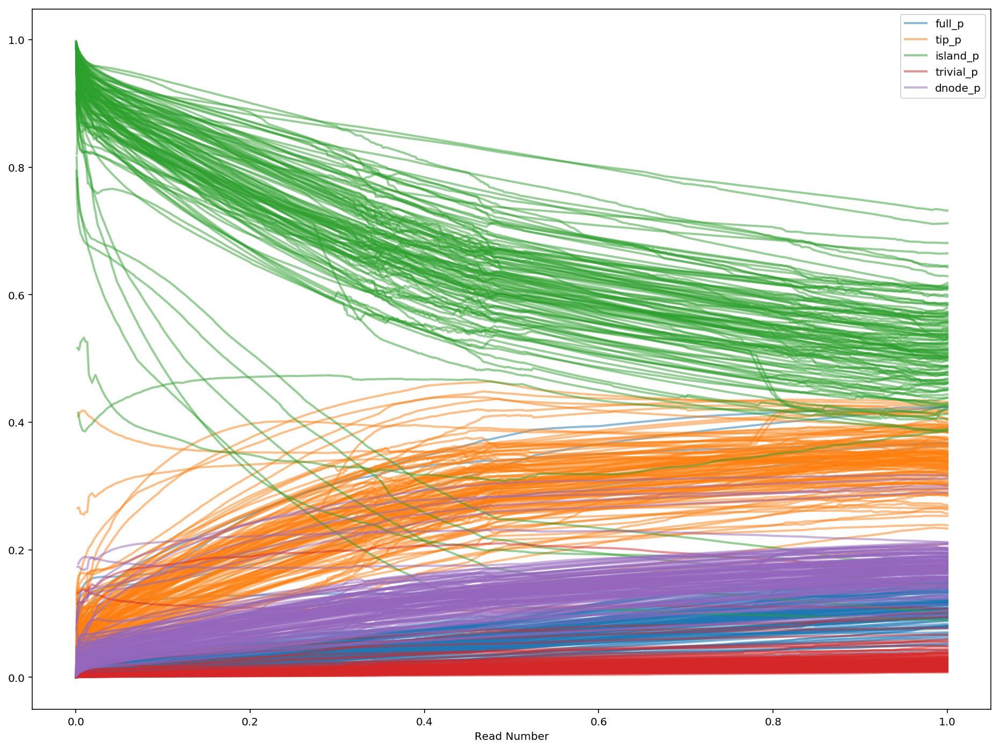

/work/boink/work/MMETSP.unode_meta.png

In [13]:
with FigureManager(filename='MMETSP.unode_meta.png', figsize=(16,12), show=True) as (fig, ax):
    color_cycle = ax._get_lines.prop_cycler
    
    for col in prop_cols:
        color = next(color_cycle)['color']
        for name, data in project_data.items():
            ax.plot(data['t'], data[col], lw=2, alpha=.5, c=color, label=col)
             #         title='Proportion of Unitig-Node Types')
    ax.set_xlabel('Read Number')
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = OrderedDict(zip(labels, handles))
    ax.legend(by_label.values(), by_label.keys())
    
FileLink('MMETSP.unode_meta.png')

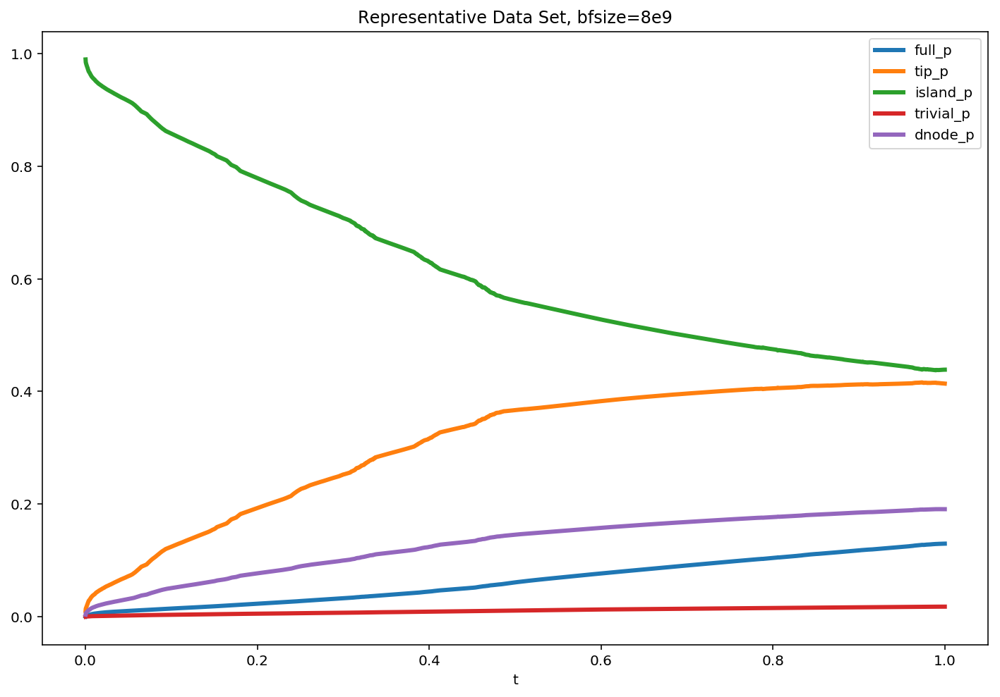

/work/boink/work/MMETSP1075.unode_meta.png

In [39]:
with FigureManager(filename='MMETSP1075.unode_meta.png', figsize=(12,8), show=True) as (fig, ax):
    
    data = project_data['MMETSP1075']
    data[prop_cols + ['t']].plot(x='t', lw=3, ax=ax)
    ax.set_title('Representative Data Set, bfsize='+data.bfsize)
    ax.legend()

    
FileLink('MMETSP1075.unode_meta.png')

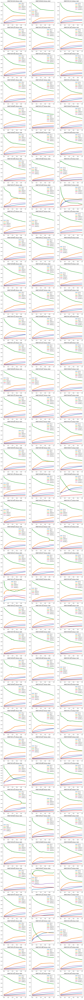

/work/boink/work/MMETSP.unode_meta.per_project.png

In [14]:
nrows = len(project_data) // 3
ncols = 3
with FigureManager(filename='MMETSP.unode_meta.per_project.png',
                   nrows=nrows, ncols=ncols, figsize=(15,5 * nrows), show=True) as (fig, ax_mat):
    color_cycle = ax._get_lines.prop_cycler
        
    for i, (name, data) in enumerate(project_data.items()):
        row = i // ncols
        col = i % ncols
        try:
            data[prop_cols + ['t']].plot(x='t', lw=3, ax=ax_mat[row][col])
            ax_mat[row][col].set_title(name + ' bfsize='+data.bfsize)
            ax_mat[row][col].legend()
        except IndexError:
            pass
    
FileLink('MMETSP.unode_meta.per_project.png')

In [15]:
def compute_slope(data, t):
    rise = data[1:].values - data[:-1].values
    run  = t[1:].values - t[:-1].values
    return rise / run

In [61]:
def find_slopes(data, cols):
    slopes = {}
    for col in cols:
        slope_col = 'd_{0}_dt'.format(col)
        slopes[slope_col] = compute_slope(data[col], data['t'])
    return pd.DataFrame(slopes, index=data['t'][1:])

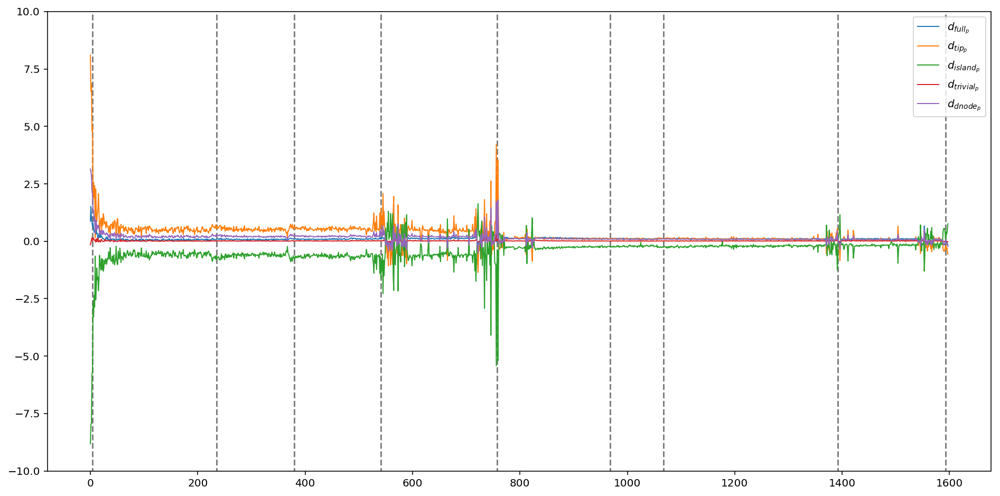

In [57]:
MMETSP1129 = project_data['MMETSP1129']

with FigureManager(figsize=(16,8), show=True) as (fig, ax):
    slopes = {}

    for col in prop_cols:
        d_col_dt = compute_slope(MMETSP1129[col], MMETSP1129['t'])
        d_col_dt = pd.Series(d_col_dt)
        #smoothed = d_col_dt.rolling(5, win_type='boxcar').mean().dropna()
        ax.plot(d_col_dt, label='$d_{{{0}}}$'.format(col), lw=1)
        slopes[col] = d_col_dt
    synthetic = np.abs(slopes['island_p']) + np.abs(slopes['tip_p'])
    #ax.plot(synthetic, label='Synethic', lw=1)
    peaks = signal.find_peaks_cwt(synthetic, np.arange(10,100))
    ax.vlines(peaks, ymax=20, ymin=-20, linestyles='dashed', alpha=.5)
    ax.legend()
    ax.set_ylim(bottom=-10, top=10)

In [18]:
def get_title(name):
    score = round(transrate_scores[name]['score'].values[0], 3)
    optimal = round(transrate_scores[name]['optimal_score'].values[0], 3)
    svo = round(score / optimal, 3)
    gc = round(transrate_scores[name]['gc'].values[0], 3)
    gc_skew = round(transrate_scores[name]['gc_skew'].values[0], 3)
    title = f'{name} {data.bfsize} SCORE={score} OPTIMAL={optimal}\n SVO={svo} GC={gc} GC_SKEW={gc_skew}'
    return score, optimal, svo, gc, gc_skew, title

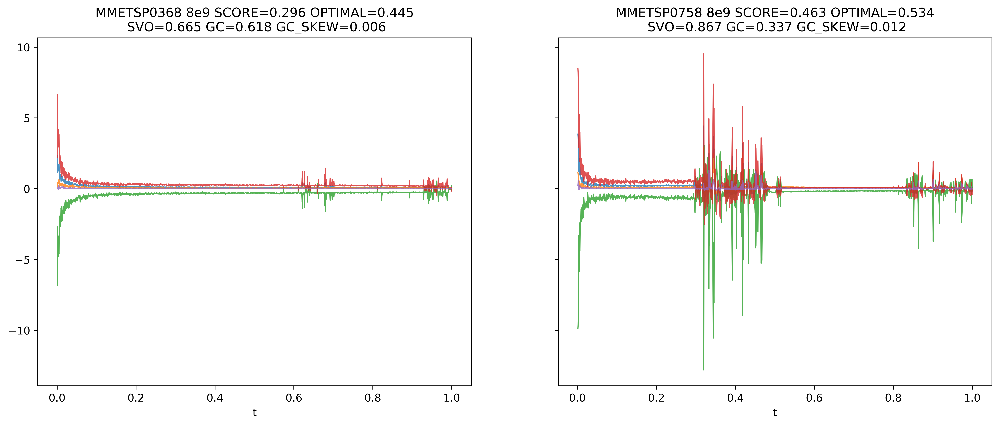

/work/boink/work/MMETSP.good_v_bad.signals.pdf

In [101]:
def get_gc(tup):
    name, _ = tup
    trsrt = transrate_scores[name]
    return trsrt['gc'].values[0]

with FigureManager(filename='MMETSP.good_v_bad.signals.pdf',
                  ncols=2, figsize=(16,6), show=True, sharey=True) as (fig, ax_mat):
    for i, (name, data) in enumerate(((n, project_data[n]) for n in ['MMETSP0368', 'MMETSP0758'])):
        col = i % 2
        d_data = find_slopes(data, prop_cols)

        score, optimal, svo, gc, gc_skew, _title = get_title(name)

        d_data.plot(lw=1, alpha=0.8,  ax=ax_mat[col], legend=False)
        max_y = d_data.abs().max().max()
        
        #peaks_idx = signal.find_peaks_cwt(d_data.abs().sum(axis=1), np.arange(10,100))
        #peaks_t = d_data.index[peaks_idx]
        #for peak_t in peaks_t:
        #    ax_mat[col].axvline(peak_t, linestyle='dashed', alpha=.5, c='gray')
        ax_mat[col].set_title(_title)
    
FileLink('MMETSP.good_v_bad.signals.pdf')

In [88]:
slopes.max()

d_dnode_p_dt       4.433789
d_full_p_dt        2.904268
d_island_p_dt     12.804552
d_tip_p_dt         9.531503
d_trivial_p_dt     1.290194
dtype: float64

In [46]:
nrows = len(project_data) // 2
ncols = 2
variances = []
scores    = []
npeaks    = []

def get_gc(tup):
    name, _ = tup
    trsrt = transrate_scores[name]
    return trsrt['gc'].values[0]

project_data = OrderedDict(sorted(project_data.items(), key=lambda tup: tup[0]))

with FigureManager(filename='MMETSP.unode_meta.signals.png',
                   nrows=nrows, ncols=ncols, figsize=(16,6 * nrows), sharey=True, show=True) as (fig, ax_mat):
    for i, (name, data) in enumerate(project_data.items()):
        row = i // 2
        col = i % 2
        slope_cols, slopes = find_slopes(data, prop_cols)

        try:
            score, optimal, svo, gc, gc_skew, title = get_title(name)
            for col_name, slope in zip(slope_cols,slopes):
                ax_mat[row][col].plot(slope, label=col_name, lw=1, alpha=.8)
                
                ax_mat[row][col].set_title(title)
                ax_mat[row][col].legend()
        except (IndexError, KeyError):
            continue
        
        peaks = signal.find_peaks_cwt(np.sum(np.abs(slopes), axis=0), np.arange(10,100))
        
        scores.append(score)
        variances.append(np.var(slopes))
        npeaks.append(len(peaks))

    
FileLink('MMETSP.unode_meta.signals.png')

/work/boink/work/MMETSP.unode_meta.signals.png

In [22]:
cor_data = pd.DataFrame({'score': scores, 'vars': variances, 'npeaks': npeaks})

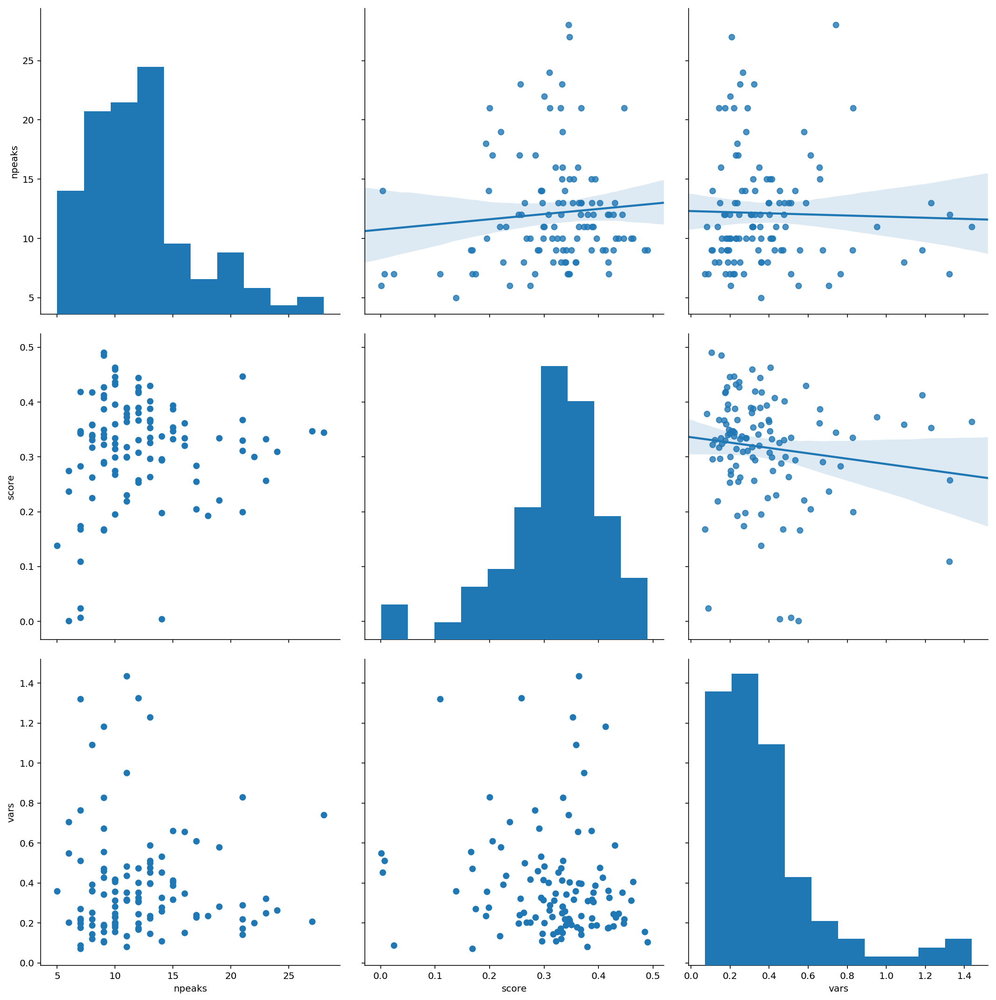

In [23]:
g = sns.PairGrid(cor_data, size=5)
g.map_diag(plt.hist)
g.map_upper(sns.regplot)
g.map_lower(plt.scatter, cmap="Blues_d")

In [24]:
def scale_to_wav(data):
    return np.int16(data/np.max(np.abs(data)) * 32767)

In [25]:
def interpolate(data, target_size):
    x = np.linspace(0, len(data), num=target_size)
    xp = np.arange(0, len(data))
    interpolated = np.interp(x, xp, data)
    return interpolated

In [26]:
def convert_to_audio_signal(data, filename, length_s=15, sampling_rate=44100, transform=np.sin):
    interpolated = interpolate(data, length_s * sampling_rate)
    transformed = transform(np.cumsum(interpolated))
    scaled = scale_to_wav(transformed)
    write_wav(filename, sampling_rate, scaled)
    return scaled

In [27]:
def convert_list(signals, *args, **kwargs):
    wav_files = []
    converted = []
    for signal in signals:
        _, wav_file = tempfile.mkstemp(suffix='.wav')
        print('Outputting .wav to', wav_file)
        converted.append(convert_to_audio_signal(signal, wav_file, *args, **kwargs))
        wav_files.append(wav_file)
    return wav_files, converted

In [28]:
def dub_wav_files(filenames, new_filename):
    base = AudioSegment.from_file(filenames[0])
    for filename in filenames[1:]:
        aud = AudioSegment.from_file(filename)
        base = base.overlay(aud)
    base.export(new_filename, format='wav')
    return AudioSegment.from_file(new_filename)

In [29]:
tip_signals = [data['tip_p'].values for data in project_data.values()]

In [30]:
tip_wavs, tip_converted = convert_list(tip_signals, length_s=30)

Outputting .wav to /tmp/tmpre5xvbpn.wav
Outputting .wav to /tmp/tmp8sflubwn.wav
Outputting .wav to /tmp/tmppsimh7d2.wav
Outputting .wav to /tmp/tmp5u9vdtjb.wav
Outputting .wav to /tmp/tmpf7d0o9_l.wav
Outputting .wav to /tmp/tmpld_1kv5u.wav
Outputting .wav to /tmp/tmpab45z0g5.wav
Outputting .wav to /tmp/tmpdnxgphxl.wav
Outputting .wav to /tmp/tmp8a_h2ymr.wav
Outputting .wav to /tmp/tmp_7wk6i9z.wav
Outputting .wav to /tmp/tmpzcx828cu.wav
Outputting .wav to /tmp/tmpgvidpxlk.wav
Outputting .wav to /tmp/tmpqmcg1w3o.wav
Outputting .wav to /tmp/tmp23rwa_kt.wav
Outputting .wav to /tmp/tmpxw2lcfce.wav
Outputting .wav to /tmp/tmp419zponc.wav
Outputting .wav to /tmp/tmp89_edpfk.wav
Outputting .wav to /tmp/tmphokeoyvm.wav
Outputting .wav to /tmp/tmp2g2_06pa.wav
Outputting .wav to /tmp/tmpw5n6sndl.wav
Outputting .wav to /tmp/tmpoucydg9t.wav
Outputting .wav to /tmp/tmp6xa9tovd.wav
Outputting .wav to /tmp/tmpdbhszmip.wav
Outputting .wav to /tmp/tmp8xdf_cve.wav
Outputting .wav to /tmp/tmpzqzs1ilk.wav


In [31]:
dub_wav_files(tip_wavs, 'MMETSP.cdbg.tips.wav')

In [566]:
cols, MMETSP1129_signals = find_slopes(MMETSP1129, ['full_p','trivial_p','island_p','tip_p','dnode_p'])

In [589]:
cols, MMETSP0201_signals = find_slopes(project_data['MMETSP0201'], ['full_p','trivial_p','island_p','tip_p','dnode_p'])

In [605]:
MMETSP0201_wavs, MMETSP0201_converted = convert_list(MMETSP0201_signals, length_s=30)

Outputting .wav to /tmp/tmp39a3x5mm.wav
Outputting .wav to /tmp/tmpwj9h3juy.wav
Outputting .wav to /tmp/tmpfg9b_e2k.wav
Outputting .wav to /tmp/tmpyv5n0ag3.wav
Outputting .wav to /tmp/tmp1k9i_8cf.wav


In [569]:
MMETSP0451_wavs, MMETSP0451_converted = convert_list(MMETSP0451_signals, length_s=20)

Outputting .wav to /tmp/tmpjv0lbaw6.wav
Outputting .wav to /tmp/tmpa_rkijzh.wav
Outputting .wav to /tmp/tmpvdwv_bwp.wav
Outputting .wav to /tmp/tmpjw1ux3md.wav
Outputting .wav to /tmp/tmps061tyej.wav


In [606]:
dub_wav_files(MMETSP0201_wavs, 'MMETSP0201.cdbg.abs.wav')

In [571]:
dub_wav_files(MMETSP0451_wavs, 'MMETSP0451.cdbg.dv.wav')

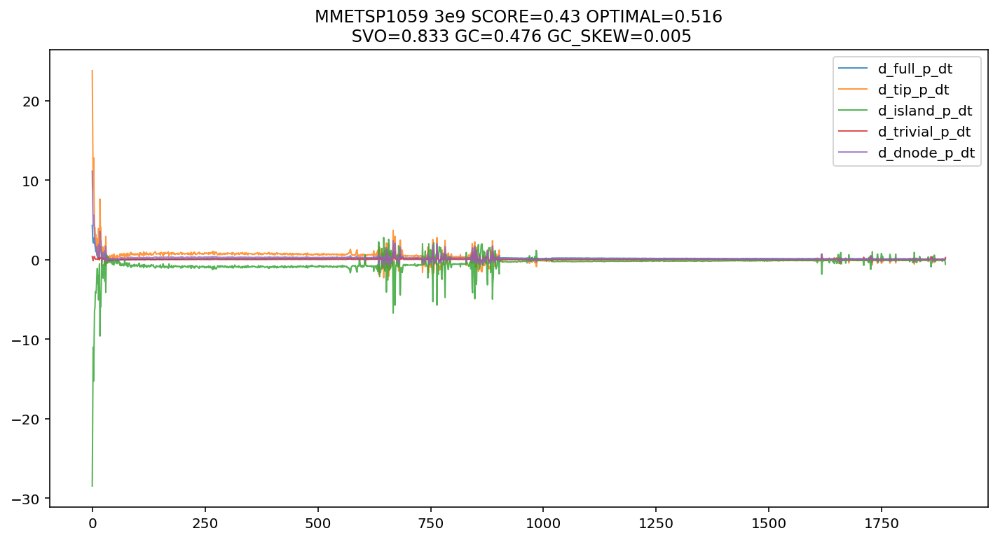

Outputting .wav to /tmp/tmpsnenz1r4.wav
Outputting .wav to /tmp/tmpz57bgzep.wav
Outputting .wav to /tmp/tmpkmnfv5k_.wav
Outputting .wav to /tmp/tmpyujq3zj7.wav
Outputting .wav to /tmp/tmpwdukxjx3.wav


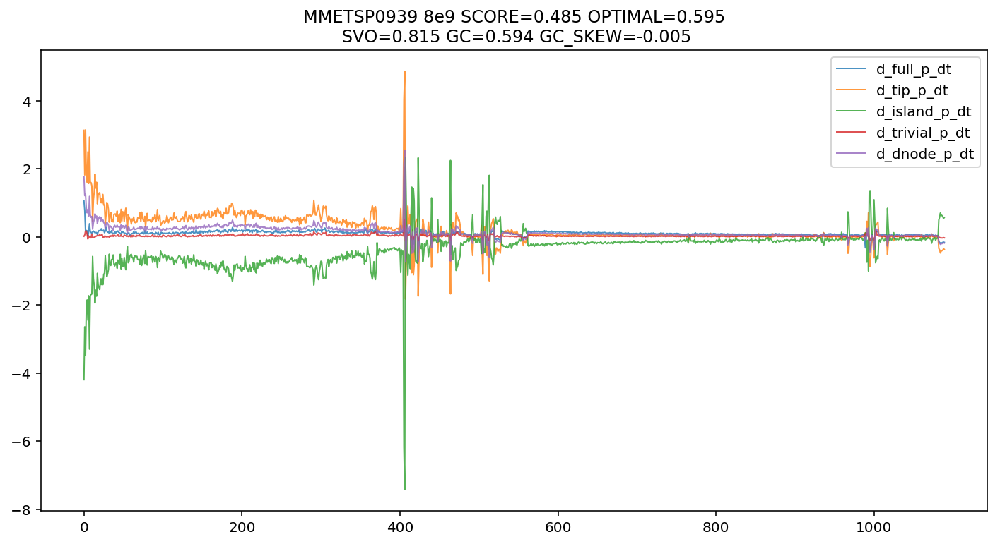

Outputting .wav to /tmp/tmp_3cybd41.wav
Outputting .wav to /tmp/tmpp7lt0on7.wav
Outputting .wav to /tmp/tmpy2eolfyo.wav
Outputting .wav to /tmp/tmp0lbehgkh.wav
Outputting .wav to /tmp/tmp9jd1l7up.wav


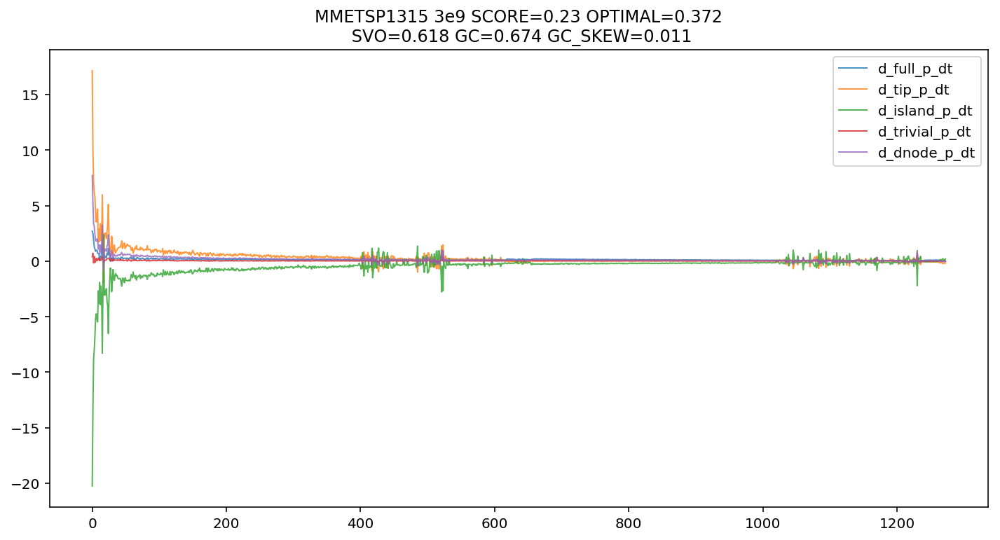

Outputting .wav to /tmp/tmpxhi4ujks.wav
Outputting .wav to /tmp/tmptnj2n7lw.wav
Outputting .wav to /tmp/tmp0ninxvdb.wav
Outputting .wav to /tmp/tmppp7_geml.wav
Outputting .wav to /tmp/tmpmcebqfap.wav


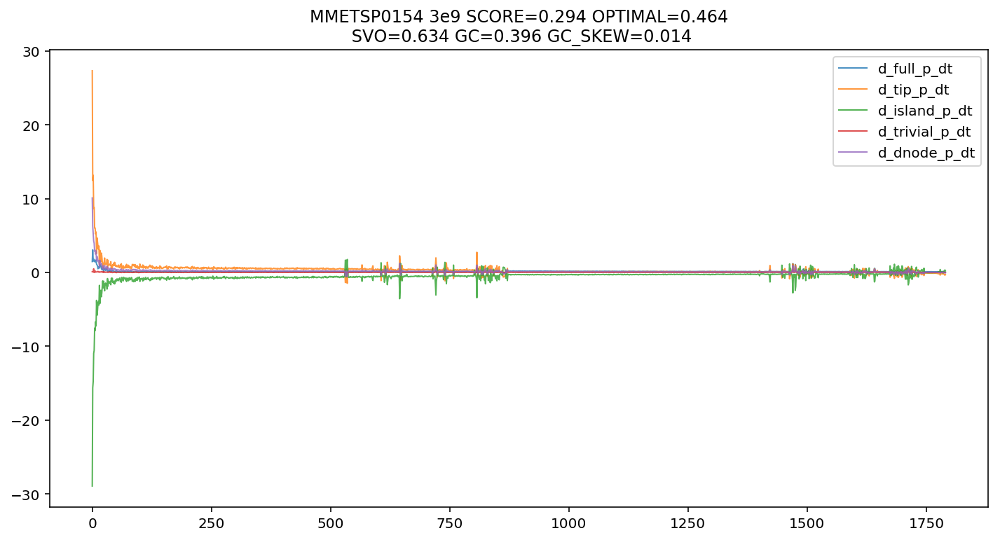

Outputting .wav to /tmp/tmp482a424i.wav
Outputting .wav to /tmp/tmp_s3x_9rl.wav
Outputting .wav to /tmp/tmpmhvr3ydv.wav
Outputting .wav to /tmp/tmpph26dnqj.wav
Outputting .wav to /tmp/tmpdgj4t671.wav


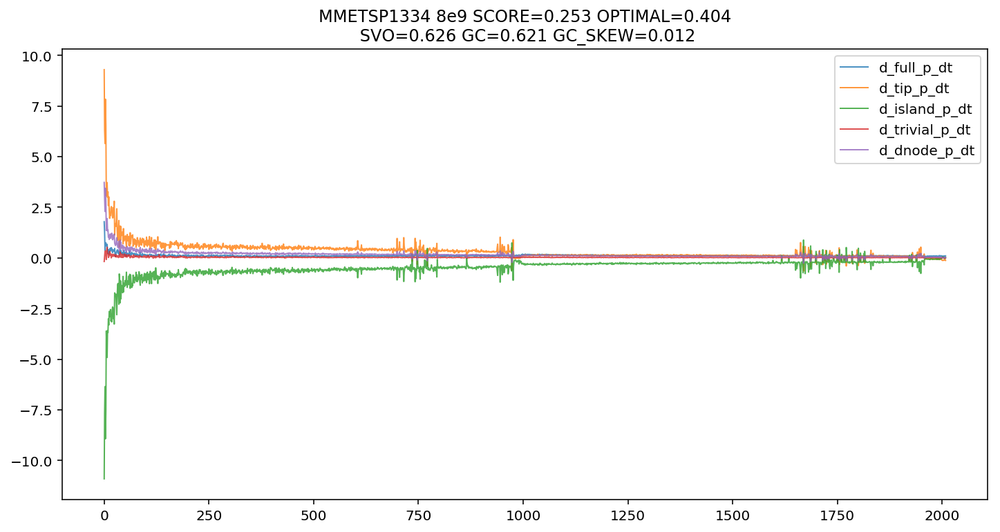

Outputting .wav to /tmp/tmpjmrpal80.wav
Outputting .wav to /tmp/tmp22cqjxy7.wav
Outputting .wav to /tmp/tmp0bf8c0t0.wav
Outputting .wav to /tmp/tmpoz8wx17x.wav
Outputting .wav to /tmp/tmp79hzbbdf.wav


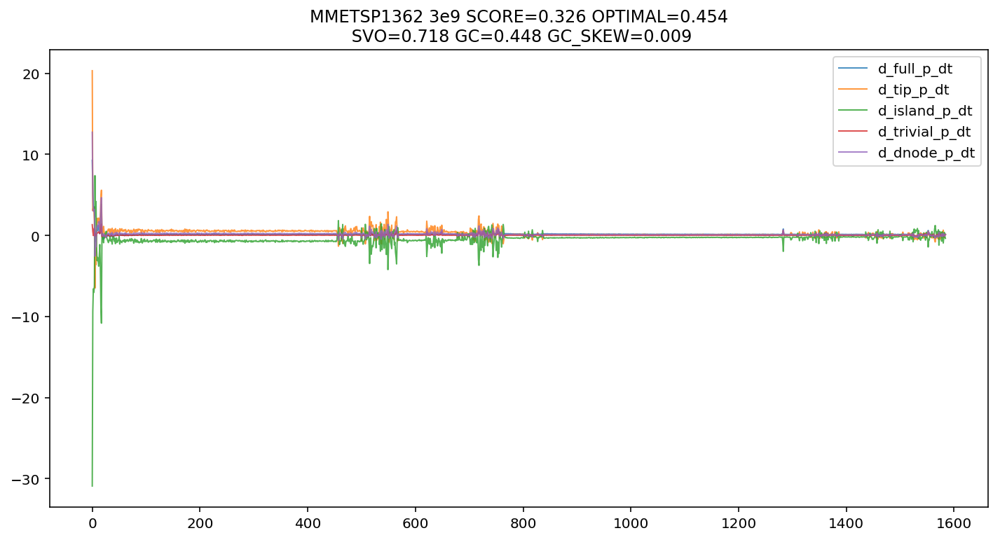

Outputting .wav to /tmp/tmpx_r7zyng.wav
Outputting .wav to /tmp/tmpv77n94o1.wav
Outputting .wav to /tmp/tmpbbefc6fw.wav
Outputting .wav to /tmp/tmpgyg47iz7.wav
Outputting .wav to /tmp/tmp3ninrhmw.wav


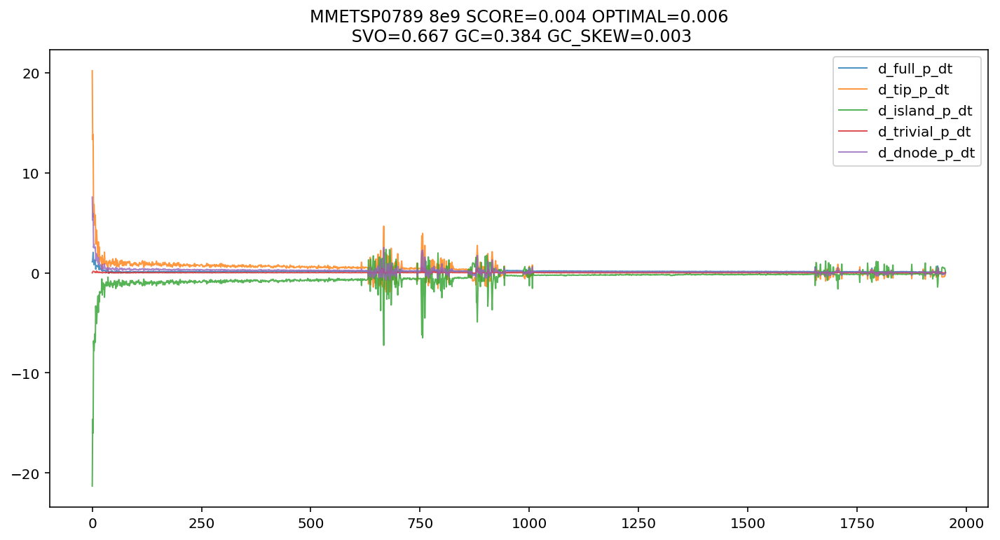

Outputting .wav to /tmp/tmppsn9i66m.wav
Outputting .wav to /tmp/tmpzn0945hb.wav
Outputting .wav to /tmp/tmpvt1m2941.wav
Outputting .wav to /tmp/tmpd9kenxxy.wav
Outputting .wav to /tmp/tmpfbs7z1ly.wav


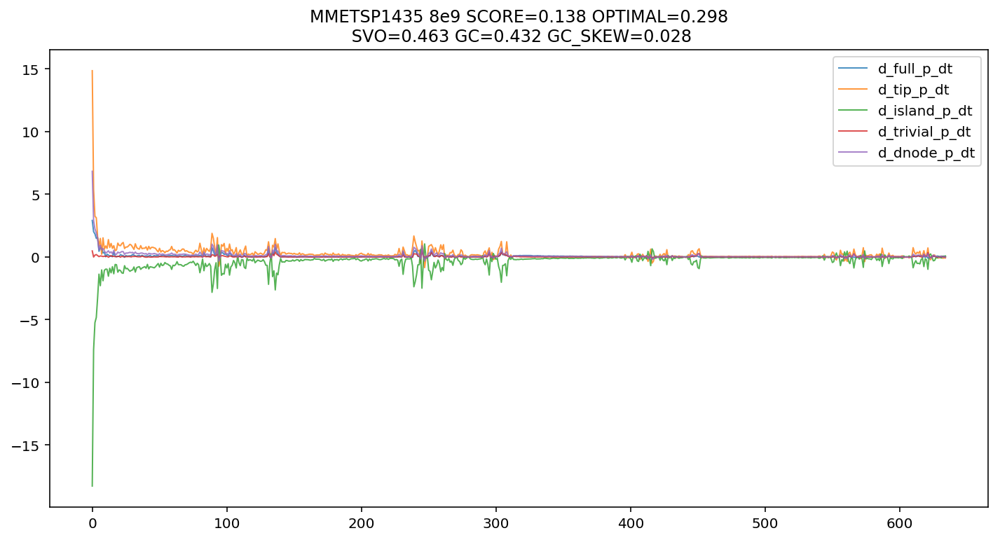

Outputting .wav to /tmp/tmpl_wwgqiu.wav
Outputting .wav to /tmp/tmpm2jv2cmx.wav
Outputting .wav to /tmp/tmpk9evac2k.wav
Outputting .wav to /tmp/tmp7eltegob.wav
Outputting .wav to /tmp/tmpcy8qx9ph.wav


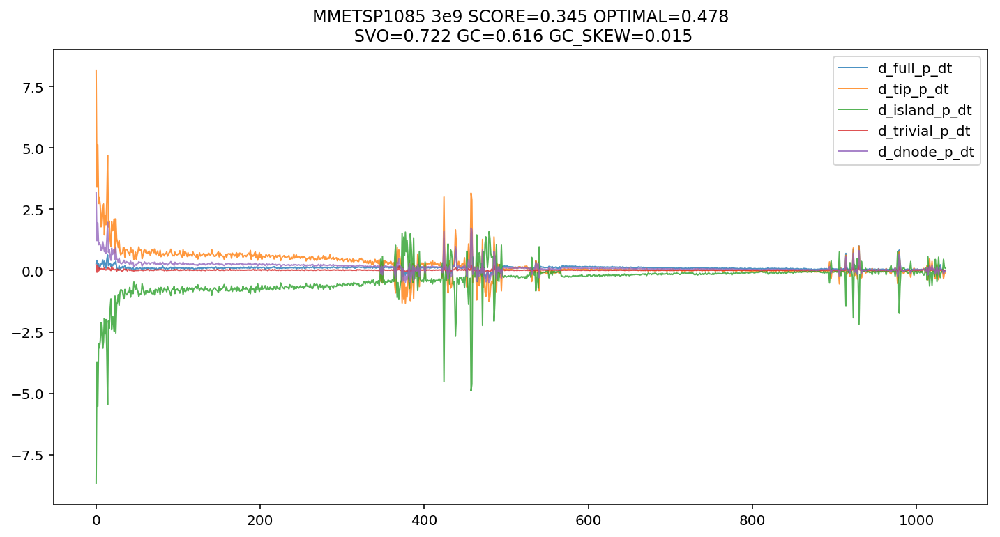

Outputting .wav to /tmp/tmp4wi3tisk.wav
Outputting .wav to /tmp/tmp8cwbosh9.wav
Outputting .wav to /tmp/tmpvero9k1c.wav
Outputting .wav to /tmp/tmpfner8kp5.wav
Outputting .wav to /tmp/tmp48ich514.wav


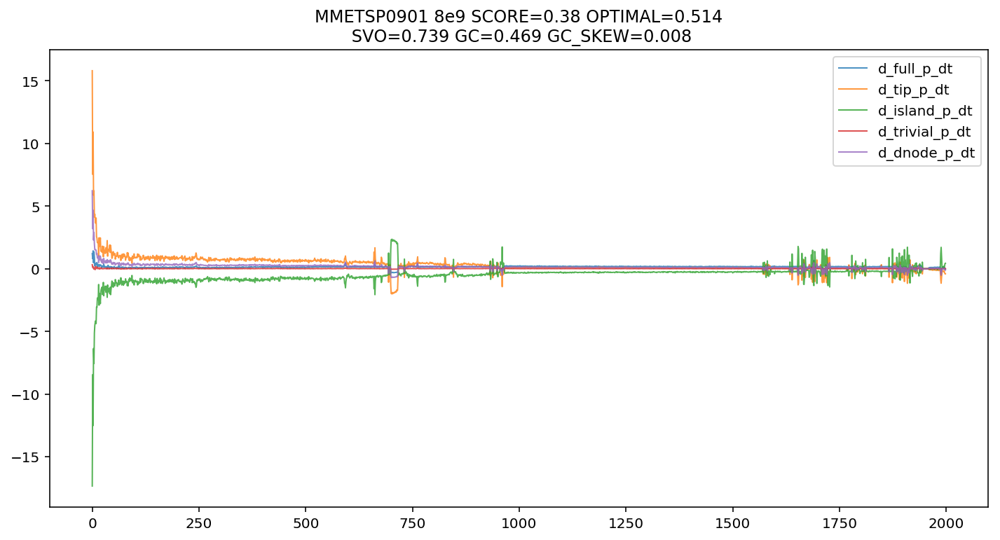

Outputting .wav to /tmp/tmpetxrrx6q.wav
Outputting .wav to /tmp/tmprez2xx3r.wav
Outputting .wav to /tmp/tmpok65r72q.wav
Outputting .wav to /tmp/tmp_2q5s738.wav
Outputting .wav to /tmp/tmp8wtxqmx5.wav


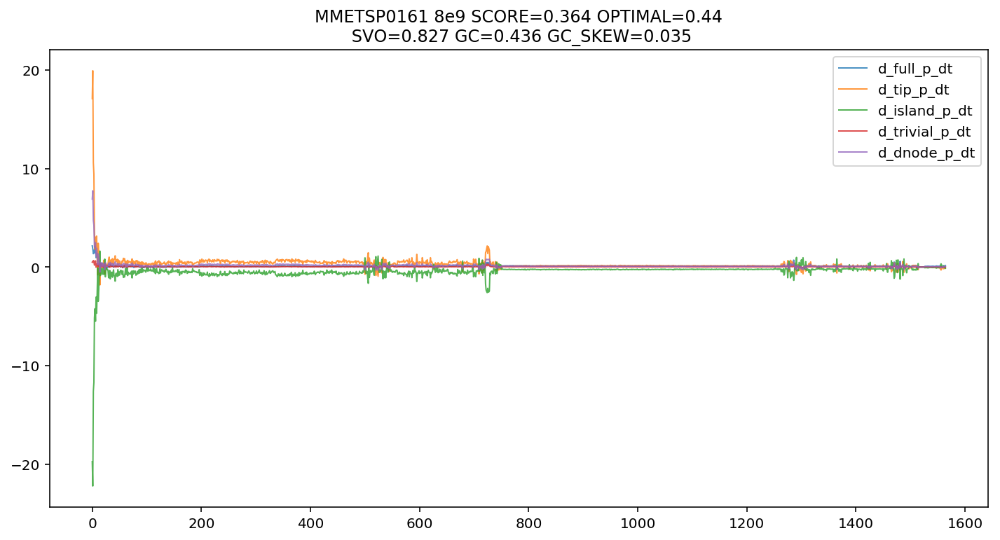

Outputting .wav to /tmp/tmpf7h707aq.wav
Outputting .wav to /tmp/tmpwe25na_6.wav
Outputting .wav to /tmp/tmpvetsg44b.wav
Outputting .wav to /tmp/tmpeqebr96e.wav
Outputting .wav to /tmp/tmpc8sfup5i.wav


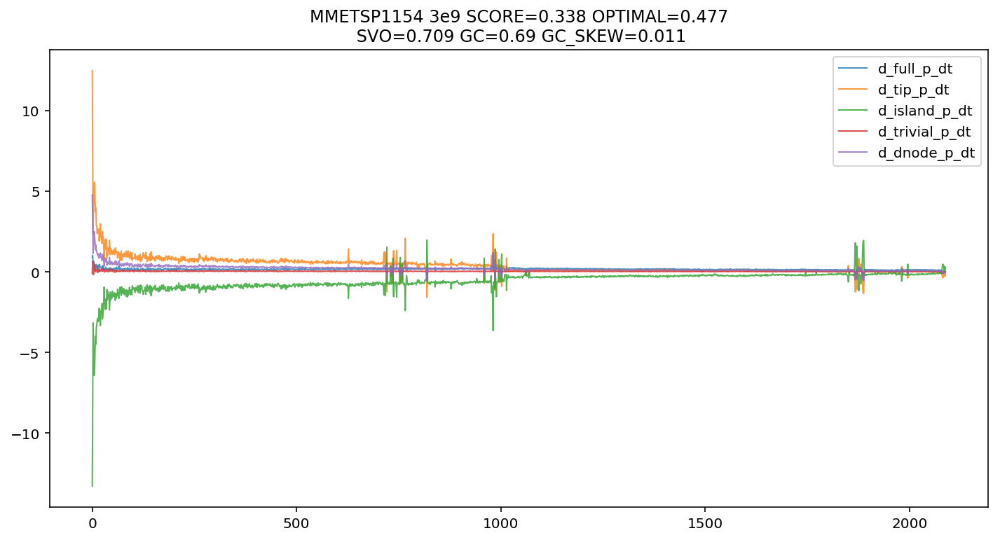

Outputting .wav to /tmp/tmpek3zwado.wav
Outputting .wav to /tmp/tmpdmy02_0_.wav
Outputting .wav to /tmp/tmpban4vp6k.wav
Outputting .wav to /tmp/tmpcrt5zrq9.wav
Outputting .wav to /tmp/tmpxa93wyfb.wav


In [699]:
audios = {}

for i, (name, data) in enumerate(project_data.items()):

    slope_cols, slopes = find_slopes(data, prop_cols)

    try:
        with FigureManager(show=True, figsize=(12,6)) as (fig, ax):
            title = get_title(name)
            for col_name, slope in zip(slope_cols, slopes):
                ax.plot(slope, label=col_name, lw=1, alpha=.8)

                ax.set_title(title[-1])
                ax.legend()
        wavs, converted = convert_list(slopes, length_s=25)
        audios[name] = dub_wav_files(wavs, name +'.cdbg.25s.dv.wav')
        display.display(audios[name])
    except (IndexError, KeyError):
        continue
    if i > 10:
        break

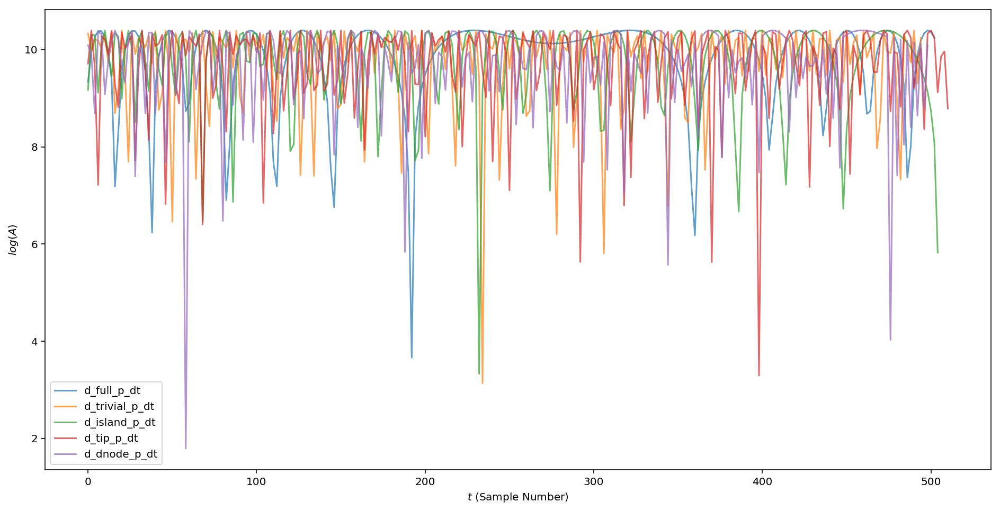

/work/boink/work/MMETSP0451_signal.png

In [573]:
with FigureManager(show=True, figsize=(16,8), filename='MMETSP0451_signal.png') as (fig, ax):
    for col, signal in zip(cols, MMETSP0451_converted):
        sliced = signal[:500]
        positive = sliced[sliced > 0]
        ax.plot(np.arange(0, len(positive) * 2, 2), np.log(positive), lw=1.5, alpha=.7, label=col)
    ax.legend()
    ax.set_ylabel('$log(A)$')
    ax.set_xlabel('$t$ (Sample Number)')
FileLink('MMETSP0451_signal.png')

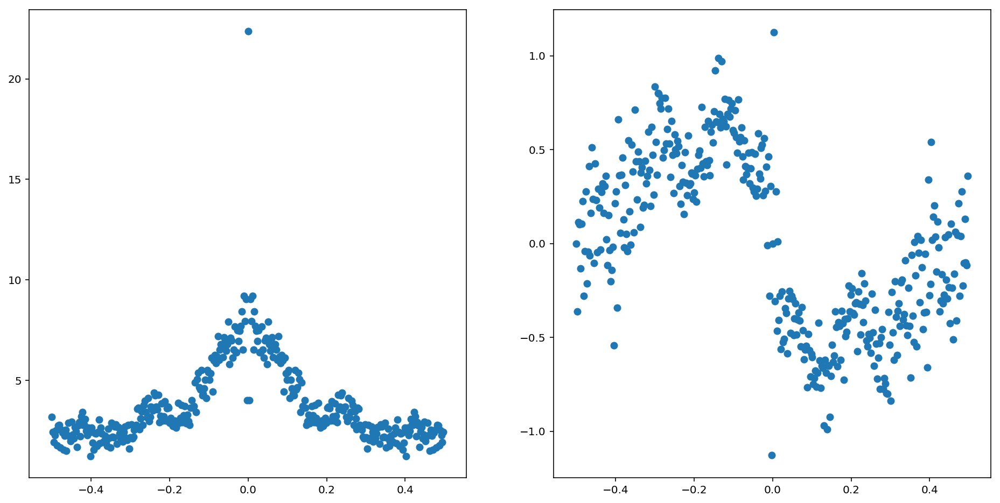

In [524]:
Y    = np.fft.fft(MMETSP0451_signals[0])
freq = np.fft.fftfreq(len(MMETSP0451_signals[0]))

with FigureManager(show=True, ncols=2, figsize=(16, 8)) as (fig, ax_mat):
    ax_mat[0].scatter( freq, numpy.abs(Y) )
    ax_mat[1].scatter( freq, numpy.angle(Y) )


In [664]:
transrate_scores['MMETSP1129']

,assembly,n_seqs,smallest,largest,n_bases,mean_len,n_under_200,n_over_1k,n_over_10k,n_with_orf,...,p_contigs_uncovbase,contigs_uncovered,p_contigs_uncovered,contigs_lowcovered,p_contigs_lowcovered,contigs_segmented,p_contigs_segmented,score,optimal_score,cutoff
0,/mnt/home/ljcohen/mmetsp_assemblies_trinity2.2...,28337,201,14042,27500777,970.49007,0,9981,9,14104,...,0.29696,996,0.03515,17728,0.62561,1095,0.03864,0.42689,0.53702,0.43999


In [674]:
transrate = pd.concat(transrate_scores)
transrate.head()
transrate.reset_index(inplace=True)
del transrate['level_1']
transrate.set_index('level_0', inplace=True)
del transrate['assembly']

In [675]:
transrate.head()

,n_seqs,smallest,largest,n_bases,mean_len,n_under_200,n_over_1k,n_over_10k,n_with_orf,mean_orf_percent,...,p_contigs_uncovbase,contigs_uncovered,p_contigs_uncovered,contigs_lowcovered,p_contigs_lowcovered,contigs_segmented,p_contigs_segmented,score,optimal_score,cutoff
level_0,,,,,,,,,,,,,,,,,,,,,
MMETSP0004,33559,201,17276,27919170,831.94285,0,9448,3,16820,81.26381,...,0.35728,1021,0.03042,19756,0.58869,1807,0.05385,0.38093,0.49164,0.52275
MMETSP0005,32824,201,11058,27684811,843.43197,0,9573,2,16407,80.15649,...,0.35386,1351,0.04116,17943,0.54664,2106,0.06416,0.38214,0.48691,0.46347
MMETSP0006,47463,201,15370,33886777,713.96197,0,10216,2,20242,80.79508,...,0.28420,1286,0.02709,31515,0.66399,2069,0.04359,0.38143,0.48273,0.45160
MMETSP0007,30922,201,6567,16617786,537.40981,0,3245,0,7980,71.01950,...,0.31537,1987,0.06426,16773,0.54243,3401,0.10999,0.27164,0.40947,0.21245
MMETSP0009,54275,201,10587,35069494,646.14452,0,9649,1,18643,80.37076,...,0.33163,2225,0.04099,36756,0.67722,2943,0.05422,0.25534,0.37249,0.32094


In [683]:
transrate_embedded = TSNE(n_components=2, perplexity=15).fit_transform(transrate)

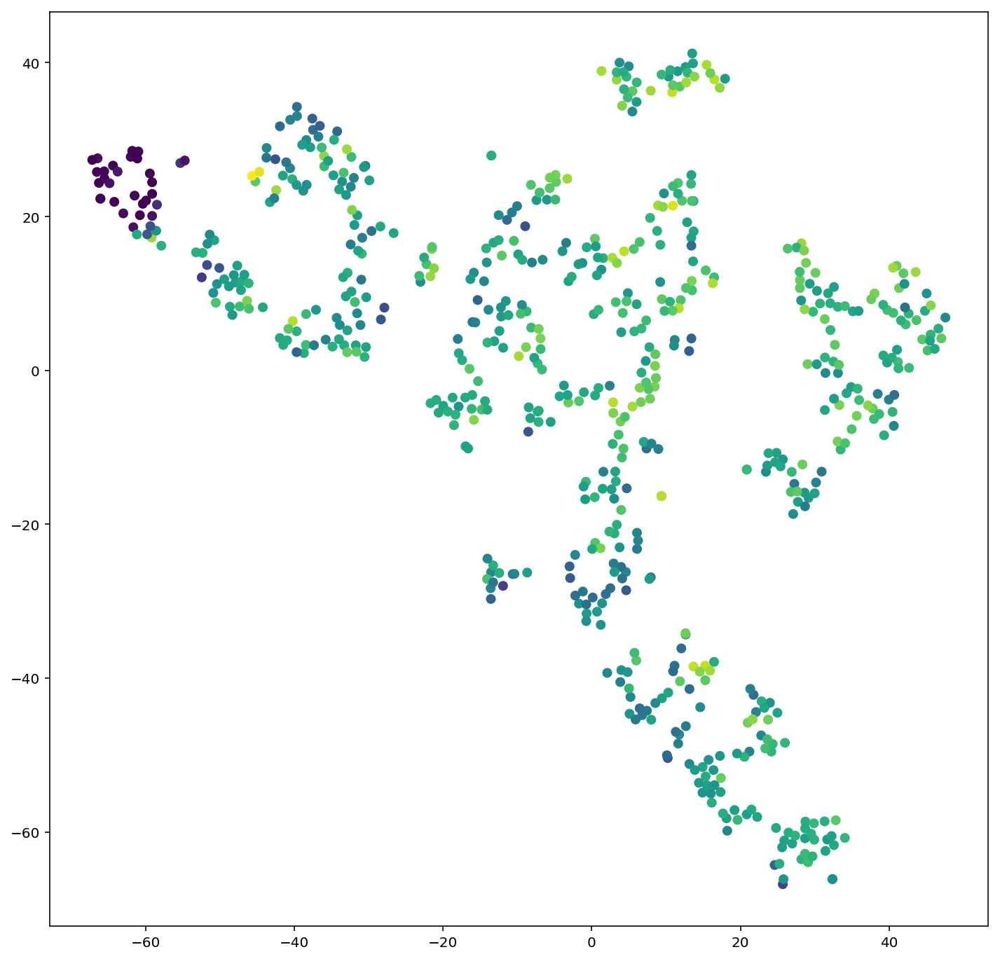

In [684]:
colorby = 'score'
with FigureManager(show=True, figsize=(12,12)) as (fig, ax):
    ax.scatter(transrate_embedded[:,0], transrate_embedded[:,1], c=transrate[colorby].values)

In [48]:
interpolated = {}
for name, data in project_data.items():
    for col in prop_cols:
        interpolated[name] = interpolated.get(name, np.zeros(5000)) + np.abs(interpolate(data[col], 5000))
interpolated = pd.DataFrame(interpolated)

In [51]:
from sklearn.manifold import TSNE
signal_embedded = TSNE(n_components=2, perplexity=15).fit_transform(interpolated.T)

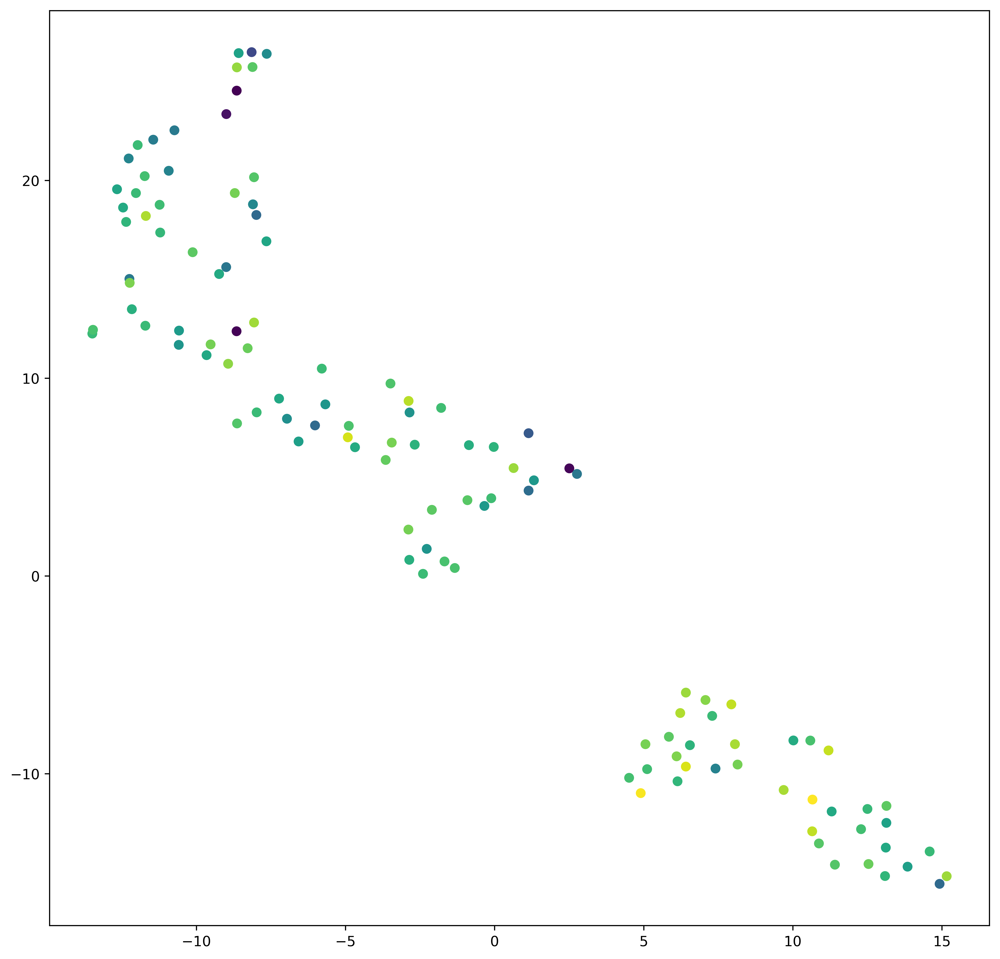

/work/boink/work/tsne_synthetic_mmetsp_ts_score.png

In [106]:
colorby = 'score'
with FigureManager(show=True, figsize=(12,12), filename='tsne_synthetic_mmetsp_ts_score.png') as (fig, ax):
    names = list(interpolated.T.index)
    colors = np.array([transrate_scores[name][colorby].values[0] for name in names])
    top = max(colors)
    colors = colors / top
    ax.scatter(signal_embedded[:,0], signal_embedded[:,1], c=colors)
FileLink('tsne_synthetic_mmetsp_ts_score.png')

array([ 24.181944,  24.128162,  24.054003, ..., -79.1969  , -79.192955,
       -79.19293 ], dtype=float32)